# Importy

In [1]:
!pip install datashader
!pip install holoviews hvplot colorcet
!pip install geoviews

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.2/511.2 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 33.2 MB/s eta 0:00:00


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import copy
from copy import deepcopy
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib as mpl
import datashader as ds
import datashader.transfer_functions as tf
import colorcet as cc
import holoviews as hv
from holoviews.operation.datashader import datashade
import geoviews as gv
import geoviews.tile_sources as gts
from holoviews import opts
from IPython.display import IFrame
from IPython.core.display import display
from bokeh.plotting import show, output_notebook
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
import pickle
import seaborn as sns
import sklearn
from sklearn import tree
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score, precision_score, recall_score, classification_report, jaccard_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_selection import mutual_info_classif
from typing import Optional, Tuple, List
from pandas import DataFrame
from imblearn.over_sampling import RandomOverSampler, SMOTE
from bokeh.layouts import row
import joblib

# Zaladowanie zbioru danych NASA

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!git clone https://github.com/PiotrMaciejKowalski/BigData2024Project.git

Cloning into 'BigData2024Project'...
remote: Enumerating objects: 1840, done.
remote: Counting objects: 100% (542/542), done.
remote: Compressing objects: 100% (290/290), done.
remote: Total 1840 (delta 422), reused 262 (delta 252), pack-reused 1298
Receiving objects: 100% (1840/1840), 65.00 MiB | 6.16 MiB/s, done.
Resolving deltas: 100% (1034/1034), done.
Updating files: 100% (147/147), done.


In [5]:
!chmod 755 /content/BigData2024Project/src/setup.sh
!/content/BigData2024Project/src/setup.sh

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.0/236.0 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 514.7/514.7 kB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 453.8/453.8 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 306.6/306.6 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 25.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 36.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 468.9/468.9 kB 34.2 MB/s eta 0:00:00
  Attempting uninstall: platformdirs
    Found existing installation: platformdirs 4.1.0
    Uninstalling platformdirs-4.1.0:
      Successfully uninstalled platformdirs-4.1.0
  Attempting uninstall: keyring
    Found existing installation: keyring 23.5.0
    Uninsta

In [6]:
import sys
sys.path.append('/content/BigData2024Project/src')

In [7]:
from start_spark import initialize_spark
initialize_spark()

In [8]:
from big_mess.loaders import default_loader
from big_mess.city_detector import City_Geolocalization_Data
from pyspark.sql import SparkSession, DataFrame as SparkDataFrame, functions as F

In [9]:
spark = SparkSession.builder\
        .master("local")\
        .appName("Colab")\
        .config('spark.ui.port', '4050')\
        .getOrCreate()

In [10]:
nasa = default_loader(spark)

In [11]:
geo_city = City_Geolocalization_Data("/content/drive/MyDrive/BigMess/NASA/geolokalizacja_wsp_NASA.csv")
nasa_city = geo_city.spark_add_geodata(nasa, city=True, state=False, country=False)
nasa_city.createOrReplaceTempView("nasa_city")

In [12]:
geo_anotated = spark.read.format('csv').option("header", True).option("inferSchema", "true").option("delimiter", ";").load('/content/drive/MyDrive/BigMess/NASA/NASA_an.csv')
geo_anotated.createOrReplaceTempView("geo_anotated")

# Funkcje

In [13]:
class BalanceDataSet():
  '''
  Two techniques for handling imbalanced data.
  '''
  def __init__(
      self,
      X: DataFrame,
      y: DataFrame
      ) -> None:
      self.X = X
      self.y = y
      assert len(self.X)==len(self.y)

  def useOverSampling(
      self,
      randon_seed: Optional[int] = 2023
      ) -> Tuple[DataFrame, DataFrame]:
    oversample = RandomOverSampler( sampling_strategy='auto',
                  random_state=randon_seed)
    return oversample.fit_resample(self.X, self.y)

  def useSMOTE(
      self,
      randon_seed: Optional[int] = 2023
      ) -> Tuple[DataFrame, DataFrame]:
    smote = SMOTE(random_state=randon_seed)
    return smote.fit_resample(self.X, self.y)

In [14]:
def summary_model(model: sklearn.base.BaseEstimator, X: pd.DataFrame, y: pd.DataFrame, labels_names: List) -> None:
  y_pred = model.predict(X)
  y_real= y
  cf_matrix = confusion_matrix(y_real, y_pred)
  group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
  group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]
  labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]
  labels = np.asarray(labels).reshape(len(labels_names),len(labels_names))
  sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Reds',xticklabels=labels_names,yticklabels=labels_names)
  plt.xlabel('Predykcja')
  plt.ylabel('Rzeczywistość')
  plt.show()

In [15]:
%cd BigData2024Project
!git checkout agregacje_kilkuletnie
sys.path.append('/content/BigData2024Project/src/big_mess')
from agg_classification_eval import  plot_map, show_metrics, prepare_agg_data_for_training

/content/BigData2024Project
M	src/setup.sh
Branch 'agregacje_kilkuletnie' set up to track remote branch 'agregacje_kilkuletnie' from 'origin'.
Switched to a new branch 'agregacje_kilkuletnie'


In [16]:
display(IFrame("https://www.google.com/maps/embed?pb=!1m14!1m12!1m3!1d13982681.959428234!2d-98.66341902257437!3d38.39997874427714!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!5e1!3m2!1spl!2spl!4v1703000232420!5m2!1spl!2spl", '800px', '500px'))

# Klasyfikacja - lipiec 2023

## Przygotowanie danych do klasyfikacji

In [17]:
nasa_city_with_anotated_07_2023 = spark.sql("""
          SELECT
          nc.lon, nc.lat, Rainf, Evap, AvgSurfT, Albedo, SoilT_40_100cm, GVEG, PotEvap, RootMoist, SoilM_100_200cm,
          CASE WHEN City = 'NaN' THEN 0 ELSE 1 END AS city,
          pustynia, step
          FROM nasa_city nc
          LEFT JOIN geo_anotated ga ON ga.lon = nc.lon AND ga.lat = nc.lat
          WHERE Year = 2023 AND Month = 7
          """)

In [18]:
df_07_2023 = nasa_city_with_anotated_07_2023.toPandas()

In [19]:
df_07_2023_anotated_without_city = df_07_2023[(df_07_2023['pustynia'].notna()) & (df_07_2023['city'] == 0)]
X = df_07_2023_anotated_without_city.loc[:,'Rainf':'SoilM_100_200cm']
y = df_07_2023_anotated_without_city['pustynia']

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=321)
X_train_bal, y_train_bal = BalanceDataSet(X_train, y_train).useSMOTE()

In [21]:
X_lat = df_07_2023_anotated_without_city.loc[:,'lat':'SoilM_100_200cm']
X_train_lat, X_test_lat, y_train_lat, y_test_lat = train_test_split(X_lat, y, test_size=0.2, random_state=321)
X_train_lat_bal, y_train_lat_bal = BalanceDataSet(X_train_lat, y_train_lat).useSMOTE()

## Las losowy

### Model (przed wykluczeniem miast)

In [22]:
model_las_m2_7_path = '/content/drive/MyDrive/BigMess/NASA/Modele/Klasyfikacja/Lasy/las_m2_7'
model_las_m2_7 = joblib.load(model_las_m2_7_path)

In [23]:
df_07_2023_predict = df_07_2023.copy()
df_07_2023_predict['Pustynia_predict'] = model_las_m2_7.predict(df_07_2023_predict.loc[:,'Rainf':'SoilM_100_200cm'])
df_07_2023_predict = df_07_2023_predict.sort_values(by=['lon', 'lat'])

### Model (po wykluczeniu miast)

In [24]:
params_gs_las = {'n_estimators': [10,20,30,40,50,60,70,80,90,100,110],
                  'max_depth': np.arange(7,11),
                  'min_samples_leaf': np.arange(4,8)}

In [25]:
gs_las = GridSearchCV(RandomForestClassifier(random_state = 2024), cv = 5, param_grid = params_gs_las, scoring = 'accuracy')
gs_las.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=2024),
             param_grid={'max_depth': array([ 7,  8,  9, 10]),
                         'min_samples_leaf': array([4, 5, 6, 7]),
                         'n_estimators': [10, 20, 30, 40, 50, 60, 70, 80, 90,
                                          100, 110]},
             scoring='accuracy')

In [26]:
las = RandomForestClassifier(random_state = 2024, **gs_las.best_params_)
las.fit(X_train_bal, y_train_bal)

RandomForestClassifier(max_depth=8, min_samples_leaf=4, n_estimators=10,
                       random_state=2024)

**Ocena na zbiorze treningowym:**

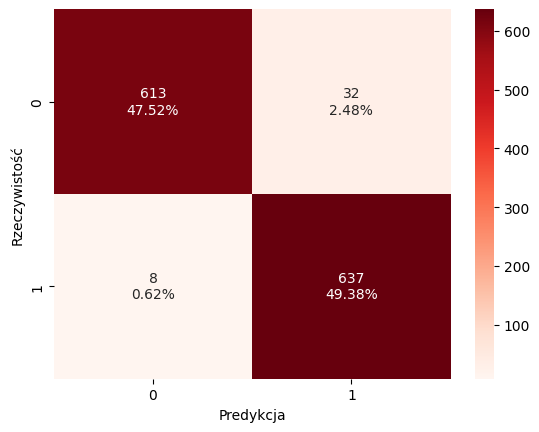

In [27]:
summary_model(las, X_train_bal, y_train_bal, ['0','1'])

In [28]:
show_metrics(las, X_train_bal, y_train_bal)

Dokładność (accuracy): 96.90%
Precyzja (precision): 95.22%
Czułość (recall): 98.76%
F1-score: 96.96%


**Ocena na zbiorze testowym:**

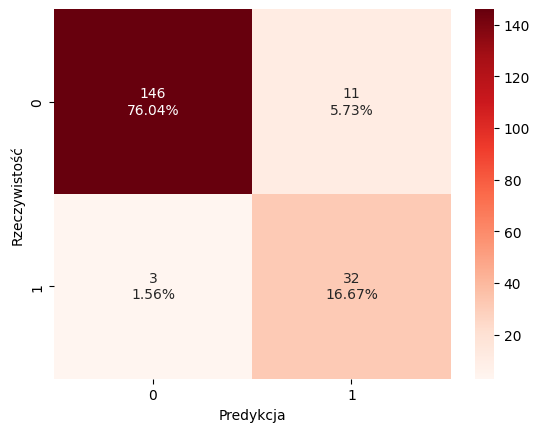

In [29]:
summary_model(las, X_test, y_test, ['0','1'])

In [30]:
show_metrics(las, X_test, y_test)

Dokładność (accuracy): 92.71%
Precyzja (precision): 74.42%
Czułość (recall): 91.43%
F1-score: 82.05%


In [31]:
df_07_2023_predict_without_city = df_07_2023.copy()
df_07_2023_predict_without_city['Pustynia_predict'] = las.predict(df_07_2023_predict_without_city.loc[:,'Rainf':'SoilM_100_200cm'])
df_07_2023_predict_without_city.loc[df_07_2023_predict_without_city['city'] == 1, 'Pustynia_predict'] = 0
df_07_2023_predict_without_city= df_07_2023_predict_without_city.sort_values(by=['lon', 'lat'])

### Porownanie

In [32]:
colormap_cluster = dict(zip(['1', '0'], ['darkorange', 'lightyellow']))
plot_with_city  = plot_map(df=df_07_2023_predict, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Las losowy (lipiec 2023) - model z miastami", point_size=3, alpha=0.5)
plot_without_city = plot_map(df=df_07_2023_predict_without_city, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Las losowy (lipiec 2023) - model bez miast", point_size=3, alpha=0.5)
output_notebook()
show(row(plot_with_city, plot_without_city))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


## Light GBM

### Model (przed wykluczeniem miast)

In [33]:
model_lgbm_m2_7_path ='/content/drive/MyDrive/BigMess/NASA/Modele/Klasyfikacja/LightGBM/lgbm_m2_7'
model_lgbm_m2_7 = joblib.load(model_lgbm_m2_7_path)

In [34]:
df_07_2023_predict_lgbm = df_07_2023.copy()
df_07_2023_predict_lgbm['Pustynia_predict'] = model_lgbm_m2_7.predict(df_07_2023_predict_lgbm.loc[:,'Rainf':'SoilM_100_200cm'])
df_07_2023_predict_lgbm = df_07_2023_predict_lgbm.sort_values(by=['lon', 'lat'])

### Model (po wykluczeniu miast)

In [35]:
params_gs_lgbm = {'n_estimators':  [10,50,100,120],
                  'num_leaves': [10,20,30,40],
                  'max_depth': np.arange(5,11)}

In [36]:
gs_lgbm= GridSearchCV(LGBMClassifier(random_state = 2024), cv = 5, param_grid = params_gs_lgbm, scoring = 'accuracy')
gs_lgbm.fit(X_train_bal, y_train_bal)

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 516, number of negative: 516
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2295
[LightGBM] [Info] Number of data points in the train set: 1032, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000

GridSearchCV(cv=5, estimator=LGBMClassifier(random_state=2024),
             param_grid={'max_depth': array([ 5,  6,  7,  8,  9, 10]),
                         'n_estimators': [10, 50, 100, 120],
                         'num_leaves': [10, 20, 30, 40]},
             scoring='accuracy')

In [37]:
lgbm = LGBMClassifier(random_state = 2024, **gs_lgbm.best_params_)
lgbm.fit(X_train_bal, y_train_bal)

[LightGBM] [Info] Number of positive: 645, number of negative: 645
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2295
[LightGBM] [Info] Number of data points in the train set: 1290, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

LGBMClassifier(max_depth=7, n_estimators=120, num_leaves=30, random_state=2024)

**Ocena na zbiorze treningowym:**

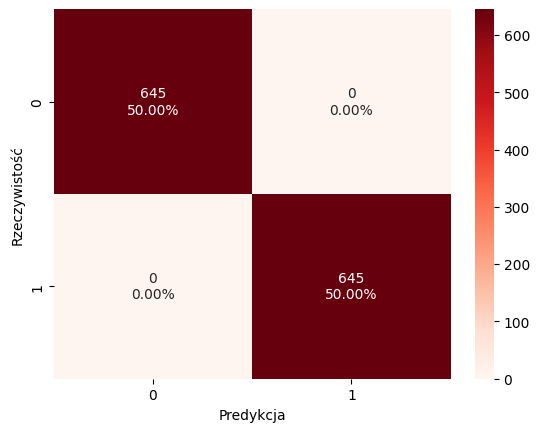

In [38]:
summary_model(lgbm, X_train_bal, y_train_bal, ['0','1'])

In [39]:
show_metrics(lgbm, X_train_bal, y_train_bal)

Dokładność (accuracy): 100.00%
Precyzja (precision): 100.00%
Czułość (recall): 100.00%
F1-score: 100.00%


**Ocena na zbiorze testowym:**

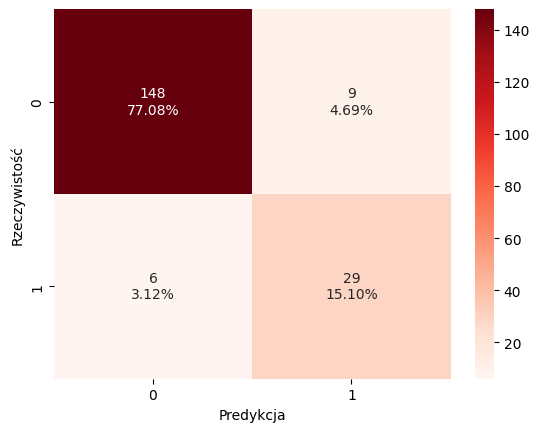

In [40]:
summary_model(lgbm, X_test, y_test, ['0','1'])

In [41]:
show_metrics(lgbm, X_test, y_test)

Dokładność (accuracy): 92.19%
Precyzja (precision): 76.32%
Czułość (recall): 82.86%
F1-score: 79.45%


In [42]:
df_07_2023_predict_without_city_lgbm = df_07_2023.copy()
df_07_2023_predict_without_city_lgbm['Pustynia_predict'] = lgbm.predict(df_07_2023_predict_without_city_lgbm.loc[:,'Rainf':'SoilM_100_200cm'])
df_07_2023_predict_without_city_lgbm.loc[df_07_2023_predict_without_city_lgbm['city'] == 1, 'Pustynia_predict'] = 0
df_07_2023_predict_without_city_lgbm= df_07_2023_predict_without_city_lgbm.sort_values(by=['lon', 'lat'])

### Porownanie

In [43]:
plot_with_city_lgbm  = plot_map(df=df_07_2023_predict_lgbm, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Light GBM (lipiec 2023) - model z miastami", point_size=3, alpha=0.5)
plot_without_city_lgbm = plot_map(df=df_07_2023_predict_without_city_lgbm, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Light GBM (lipiec 2023) - model bez miast", point_size=3, alpha=0.5)
output_notebook()
show(row(plot_with_city_lgbm, plot_without_city_lgbm))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


## Las losowy (model ze zmienna lat)

### Model (przed wykluczeniem miast)

In [44]:
model_las_m2_lat_path='/content/drive/MyDrive/BigMess/NASA/Modele/Klasyfikacja/Modele_z_lat/las_m2_lat'
model_las_m2_lat = joblib.load(model_las_m2_lat_path)

In [45]:
df_07_2023_predict_lat = df_07_2023.copy()
df_07_2023_predict_lat['Pustynia_predict'] = model_las_m2_lat.predict(df_07_2023_predict_lat.loc[:,'lat':'SoilM_100_200cm'])
df_07_2023_predict_lat = df_07_2023_predict_lat.sort_values(by=['lon', 'lat'])

### Model (po wykluczeniu miast)

In [46]:
gs_las_lat = GridSearchCV(RandomForestClassifier(random_state = 2024), cv = 5, param_grid = params_gs_las, scoring = 'accuracy')
gs_las_lat.fit(X_train_lat_bal, y_train_lat_bal)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=2024),
             param_grid={'max_depth': array([ 7,  8,  9, 10]),
                         'min_samples_leaf': array([4, 5, 6, 7]),
                         'n_estimators': [10, 20, 30, 40, 50, 60, 70, 80, 90,
                                          100, 110]},
             scoring='accuracy')

In [47]:
las_lat = RandomForestClassifier(random_state = 2024, **gs_las_lat.best_params_)
las_lat.fit(X_train_lat_bal, y_train_lat_bal)

RandomForestClassifier(max_depth=10, min_samples_leaf=4, n_estimators=70,
                       random_state=2024)

**Ocena na zbiorze treningowym:**

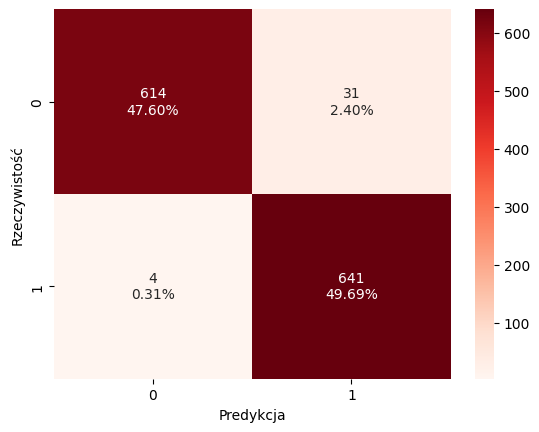

In [48]:
summary_model(las_lat, X_train_lat_bal, y_train_lat_bal, ['0','1'])

In [49]:
show_metrics(las_lat, X_train_lat_bal, y_train_lat_bal)

Dokładność (accuracy): 97.29%
Precyzja (precision): 95.39%
Czułość (recall): 99.38%
F1-score: 97.34%


**Ocena na zbiorze testowym:**

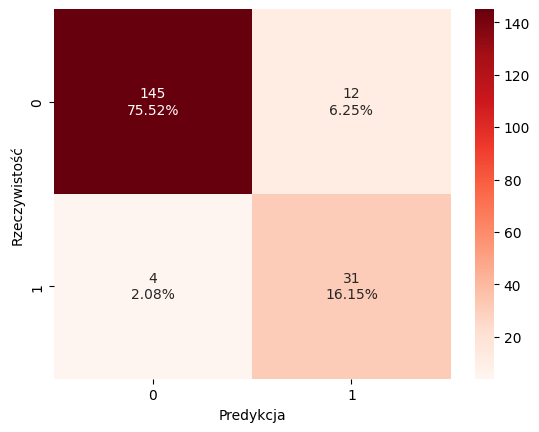

In [50]:
summary_model(las_lat, X_test_lat, y_test_lat, ['0','1'])

In [51]:
show_metrics(las_lat, X_test_lat, y_test_lat)

Dokładność (accuracy): 91.67%
Precyzja (precision): 72.09%
Czułość (recall): 88.57%
F1-score: 79.49%


In [52]:
df_07_2023_predict_without_city_lat = df_07_2023.copy()
df_07_2023_predict_without_city_lat['Pustynia_predict'] = las_lat.predict(df_07_2023_predict_without_city_lat.loc[:,'lat':'SoilM_100_200cm'])
df_07_2023_predict_without_city_lat.loc[df_07_2023_predict_without_city_lat['city'] == 1, 'Pustynia_predict'] = 0
df_07_2023_predict_without_city_lat= df_07_2023_predict_without_city_lat.sort_values(by=['lon', 'lat'])

### Porownanie

In [53]:
plot_with_city_lat  = plot_map(df=df_07_2023_predict_lat, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Las losowy ze zmienna lat (lipiec 2023) - model z miastami", point_size=3, alpha=0.5)
plot_without_city_lat = plot_map(df=df_07_2023_predict_without_city_lat, parameter_name='Pustynia_predict', colormap=colormap_cluster, title="Las losowy ze zmienna lat (lipiec 2023) - model bez miast", point_size=3, alpha=0.5)
output_notebook()
show(row(plot_with_city_lat, plot_without_city_lat))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


# Klasyfikacja - agregacje kilkuletnie

## Przygotowanie danych do klasyfikacji

In [54]:
NASA_sample_an = geo_anotated.toPandas()

In [55]:
monthly_avg_4_july2023, monthly_avg_4_july2023_an_merge = prepare_agg_data_for_training(nasa_sample_an=NASA_sample_an, year=2023, month=7, n_years=4)
monthly_avg_5_july2023, monthly_avg_5_july2023_an_merge = prepare_agg_data_for_training(nasa_sample_an=NASA_sample_an, year=2023, month=7, n_years=5)

In [56]:
city = spark.sql("""
          SELECT DISTINCT
          lon, lat,
          CASE WHEN City = 'NaN' THEN 0 ELSE 1 END AS city
          FROM nasa_city
          """).toPandas()

In [57]:
monthly_avg_4_july2023_city01 = monthly_avg_4_july2023.merge(city, left_on=['lon','lat'], right_on=['lon','lat'], how='inner')

monthly_avg_4_july2023_an_merge_city01 = monthly_avg_4_july2023_an_merge.merge(city, left_on=['lon','lat'], right_on=['lon','lat'], how='inner')
monthly_avg_4_july2023_an_merge_city = monthly_avg_4_july2023_an_merge_city01[monthly_avg_4_july2023_an_merge_city01['city'] == 0]


monthly_avg_5_july2023_city01 = monthly_avg_5_july2023.merge(city, left_on=['lon','lat'], right_on=['lon','lat'], how='inner')

monthly_avg_5_july2023_an_merge_city01 = monthly_avg_5_july2023_an_merge.merge(city, left_on=['lon','lat'], right_on=['lon','lat'], how='inner')
monthly_avg_5_july2023_an_merge_city = monthly_avg_5_july2023_an_merge_city01[monthly_avg_5_july2023_an_merge_city01['city'] == 0]

## Las losowy

### Model (przed wykluczeniem miast)

In [58]:
best_model_rf_path='/content/drive/MyDrive/BigMess/NASA/Modele/Klasyfikacja/Modele_kilkuletnia_agregacja/random_forest_5years_avg_july2023'
best_model_rf = joblib.load(best_model_rf_path)

In [59]:
monthly_avg_5_july2023_pred = monthly_avg_5_july2023.copy()
monthly_avg_5_july2023_pred['pustynia'] = best_model_rf.predict(monthly_avg_5_july2023.loc[:, [col for col in monthly_avg_5_july2023.columns if col.startswith('monthly_avg')]])

### Model (po wykluczeniu miast)

In [60]:
best_rf = RandomForestClassifier(max_depth=8, min_samples_leaf=4, n_estimators=70, random_state=3)
X = monthly_avg_5_july2023_an_merge_city.drop(columns=['lon', 'lat', 'pustynia', 'city'])
y = monthly_avg_5_july2023_an_merge_city['pustynia']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1111)

In [61]:
rf_monthly_avg_5_july2023_city = deepcopy(best_rf)
rf_monthly_avg_5_july2023_city.fit(X_train, y_train)

RandomForestClassifier(max_depth=8, min_samples_leaf=4, n_estimators=70,
                       random_state=3)

**Ocena na zbiorze treningowym:**

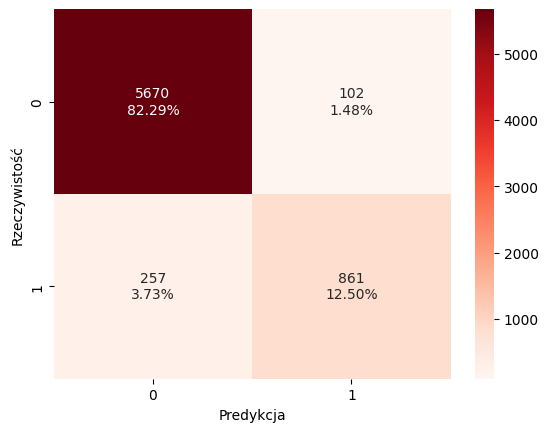

In [62]:
summary_model(rf_monthly_avg_5_july2023_city, X_train, y_train, ['0','1'])

In [63]:
show_metrics(rf_monthly_avg_5_july2023_city, X_train, y_train)

Dokładność (accuracy): 94.79%
Precyzja (precision): 89.41%
Czułość (recall): 77.01%
F1-score: 82.75%


**Ocena na zbiorze testowym:**

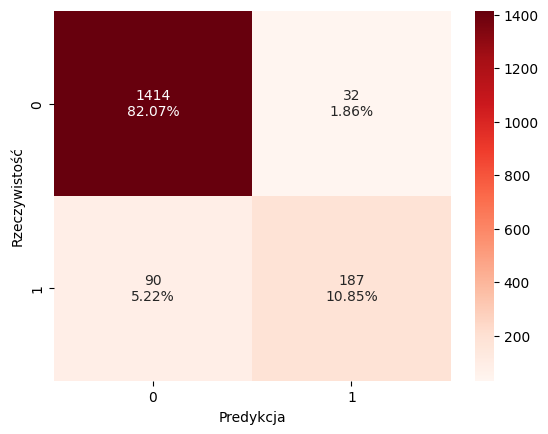

In [64]:
summary_model(rf_monthly_avg_5_july2023_city, X_test, y_test, ['0', '1'])

In [65]:
show_metrics(rf_monthly_avg_5_july2023_city, X_test, y_test)

Dokładność (accuracy): 92.92%
Precyzja (precision): 85.39%
Czułość (recall): 67.51%
F1-score: 75.40%


In [66]:
monthly_avg_5_july2023_pred_city = monthly_avg_5_july2023_city01.copy()
monthly_avg_5_july2023_pred_city['pustynia'] = rf_monthly_avg_5_july2023_city.predict(monthly_avg_5_july2023.loc[:, [col for col in monthly_avg_5_july2023.columns if col.startswith('monthly_avg')]])
monthly_avg_5_july2023_pred_city.loc[monthly_avg_5_july2023_pred_city['city'] == 1, 'pustynia'] = 0

### Porownanie

In [67]:
output_notebook()
plot_with_city = plot_map(df=monthly_avg_5_july2023_pred, parameter_name='pustynia',
              colormap=colormap_cluster,
              title='Pustynie (1) i niepustynie (0) - las losowy (lipiec 2023, średnia 5-letnia) - model z miastami',
              point_size=3, alpha=0.5)

plot_without_city = plot_map(df=monthly_avg_5_july2023_pred_city, parameter_name='pustynia',
              colormap=colormap_cluster,
              title='Pustynie (1) i niepustynie (0) - las losowy (lipiec 2023, średnia 5-letnia) - model bez miast',
              point_size=3, alpha=0.5)
show(row(plot_with_city, plot_without_city))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)


## LGBM

### Model (przed wykluczeniem miast)

In [68]:
best_model_lgbm_path='/content/drive/MyDrive/BigMess/NASA/Modele/Klasyfikacja/Modele_kilkuletnia_agregacja/lgbm_4years_avg_july2023'
best_model_lgbm = joblib.load(best_model_lgbm_path)

In [69]:
monthly_avg_4_july2023_pred_lgbm = monthly_avg_4_july2023.copy()
monthly_avg_4_july2023_pred_lgbm['pustynia'] = best_model_lgbm.predict(monthly_avg_4_july2023.loc[:, [col for col in monthly_avg_4_july2023.columns if col.startswith('monthly_avg')]])

### Model (po wykluczeniu miast)

In [70]:
best_lgbm = LGBMClassifier(max_depth=10, n_estimators=120, num_leaves=30, random_state=3)
X = monthly_avg_4_july2023_an_merge_city.drop(columns=['lon', 'lat', 'pustynia', 'city'])
y = monthly_avg_4_july2023_an_merge_city['pustynia']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1111)

In [71]:
lgbm_monthly_avg_4_july2023_city = deepcopy(best_lgbm)
lgbm_monthly_avg_4_july2023_city.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 1118, number of negative: 5772
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2295
[LightGBM] [Info] Number of data points in the train set: 6890, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.162264 -> initscore=-1.641477
[LightGBM] [Info] Start training from score -1.641477
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


LGBMClassifier(max_depth=10, n_estimators=120, num_leaves=30, random_state=3)

**Ocena na zbiorze treningowym:**

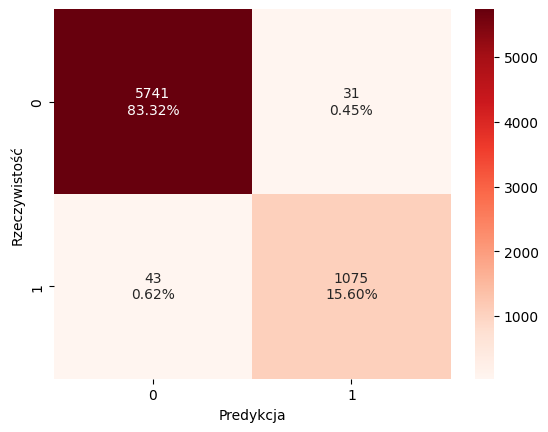

In [72]:
summary_model(lgbm_monthly_avg_4_july2023_city, X_train, y_train, ['0','1'])

In [73]:
show_metrics(lgbm_monthly_avg_4_july2023_city, X_train, y_train)

Dokładność (accuracy): 98.93%
Precyzja (precision): 97.20%
Czułość (recall): 96.15%
F1-score: 96.67%


**Ocena na zbiorze testowym:**

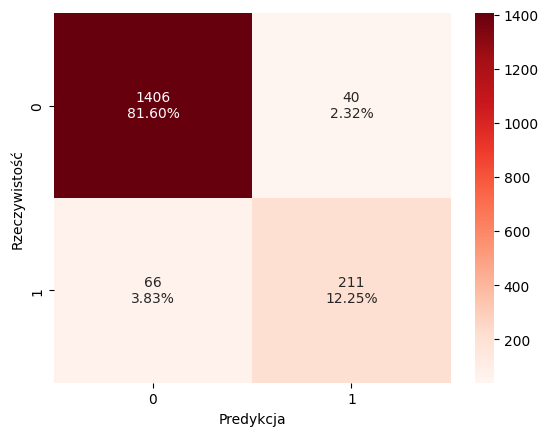

In [74]:
summary_model(lgbm_monthly_avg_4_july2023_city, X_test, y_test, ['0', '1'])

In [75]:
show_metrics(lgbm_monthly_avg_4_july2023_city, X_test, y_test)

Dokładność (accuracy): 93.85%
Precyzja (precision): 84.06%
Czułość (recall): 76.17%
F1-score: 79.92%


In [76]:
monthly_avg_4_july2023_pred_city = monthly_avg_4_july2023_city01.copy()
monthly_avg_4_july2023_pred_city['pustynia'] = lgbm_monthly_avg_4_july2023_city.predict(monthly_avg_4_july2023.loc[:, [col for col in monthly_avg_4_july2023.columns if col.startswith('monthly_avg')]])
monthly_avg_4_july2023_pred_city.loc[monthly_avg_4_july2023_pred_city['city'] == 1, 'pustynia'] = 0

### Porownanie

In [77]:
output_notebook()
plot_with_city = plot_map(df=monthly_avg_4_july2023_pred_lgbm, parameter_name='pustynia',
              colormap=colormap_cluster,
              title='Pustynie (1) i niepustynie (0) - LGBM (lipiec 2023, średnia 4-letnia) - model z miastami',
              point_size=3, alpha=0.5)

plot_without_city = plot_map(df=monthly_avg_4_july2023_pred_city, parameter_name='pustynia',
              colormap=colormap_cluster,
              title='Pustynie (1) i niepustynie (0) - LGBM (lipiec 2023, średnia 4-letnia) - model bez miast',
              point_size=3, alpha=0.5)
show(row(plot_with_city, plot_without_city))

/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
/usr/local/lib/python3.10/dist-packages/holoviews/core/util.py:1585: PanelDeprecationWarning: 'param_value_if_widget' is deprecated and will be removed in version 1.4, use 'transform_reference' instead.
  value = param_value_if_widget(value)
